In [1]:
import os

import pandas as pd
from dotenv import load_dotenv
from sqlalchemy import create_engine
import altair as alt

In [2]:
alt.renderers.enable("mimetype");

In [3]:
load_dotenv()

connection_string = "postgresql://{user}:{password}@{host}:{port}/{db}".format(
    user=os.getenv('DB_USER'),
    password=os.getenv('DB_PASSWORD'),
    host=os.getenv('DB_HOST'),
    port=os.getenv('DB_PORT'),
    db=os.getenv('DB_NAME')
)
engine = create_engine(connection_string)

### XC points

In [4]:
query = """
SELECT
    DATE_PART('year', date) AS year,
    DATE_PART('month', date) AS month,
    points
FROM source.flights
"""
points = pd.read_sql(query, engine)

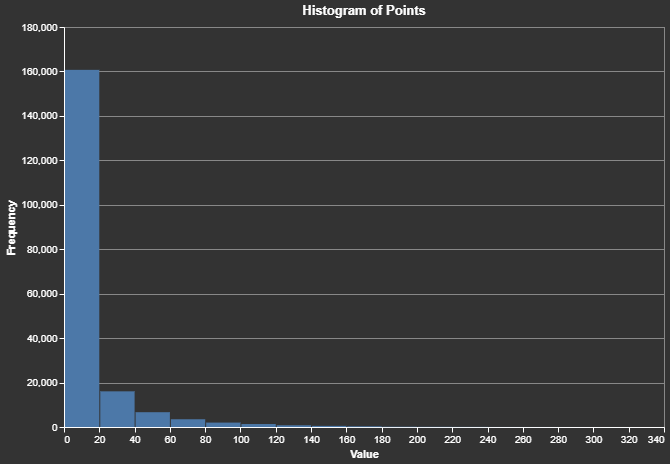

In [5]:
histogram = alt.Chart(points).mark_bar().encode(
    alt.X('points:Q', bin=alt.Bin(maxbins=30), title='Value'),
    alt.Y('count()', title='Frequency')
).properties(
    width=600,
    height=400,
    title='Histogram of Points'
)
alt.data_transformers.disable_max_rows()
histogram.show()

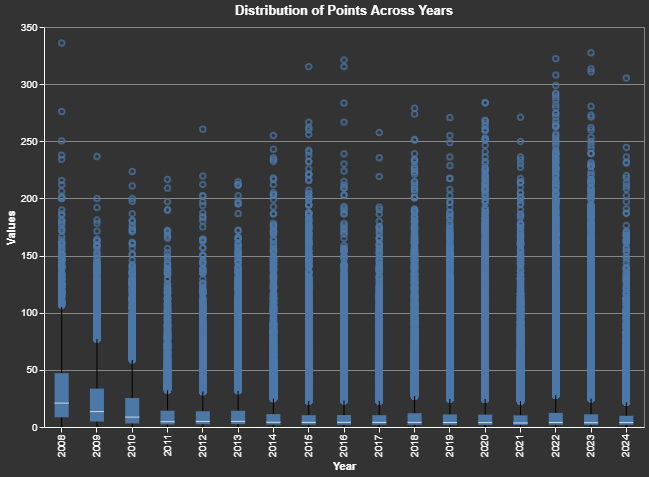

In [6]:
boxplot = alt.Chart(points).mark_boxplot().encode(
    x=alt.X('year:O', title='Year'),
    y=alt.Y('points:Q', title='Values'),
).properties(
    width=600,
    height=400,
    title='Distribution of Points Across Years'
)
boxplot.show()

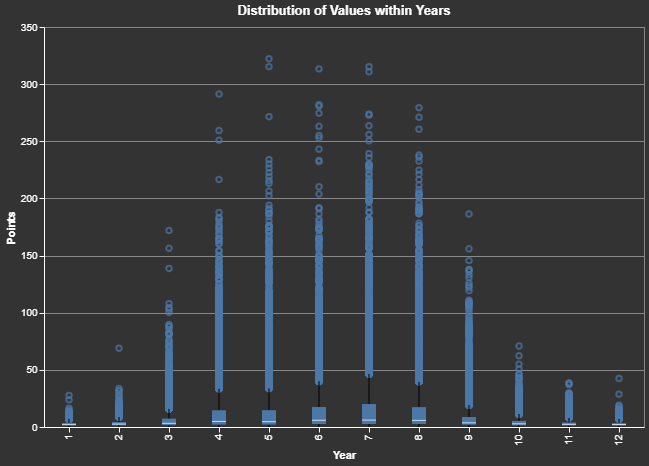

In [7]:
boxplot = alt.Chart(points.sample(frac=0.25)).mark_boxplot().encode(
    x=alt.X('month:O', title='Year'),
    y=alt.Y('points:Q', title='Points'),
).properties(
    width=600,
    height=400,
    title='Distribution of Values within Years'
)
boxplot.show()